In [ ]:
# IST 718 - Big Data Analytics
# Team 3 - Josh Biggs-Bauer, Noe Fernandes, Melissa Maverick, & Nick Waine

# H&M Personalized Fashion Recommendations

# New Section

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from sklearn.model_selection import train_test_split
os.getcwd()
os.chdir('/content/drive/Shareddrives/Team_3')

In [ ]:
# Check that current working directory is Team_3
os.getcwd()

'/content/drive/Shareddrives/Team_3'

In [ ]:
customers = pd.read_csv('customers.csv')

In [ ]:
articles = pd.read_csv('articles.csv')

In [ ]:
train = pd.read_csv('transactions_train.csv')

# First Look at Data

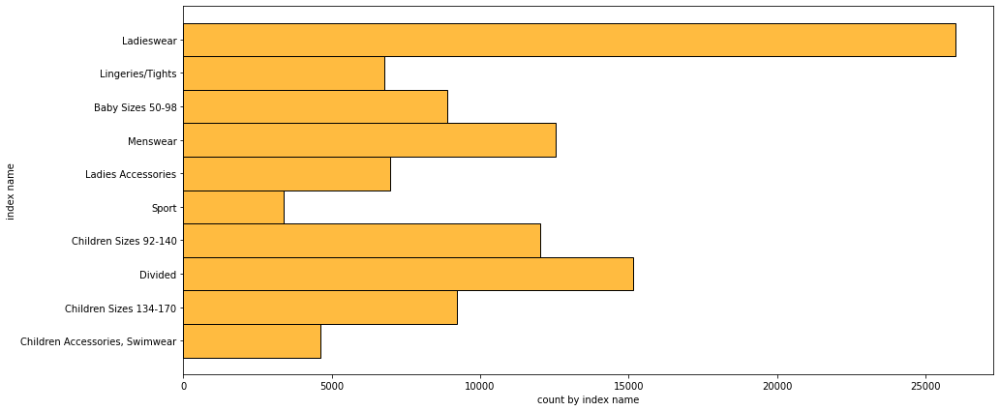

In [ ]:
# Checking which categories account for most items

f, ax = plt.subplots(figsize=(15, 7))
ax = sns.histplot(data=articles, y='index_name', color='orange')
ax.set_xlabel('count by index name')
ax.set_ylabel('index name')
plt.show()

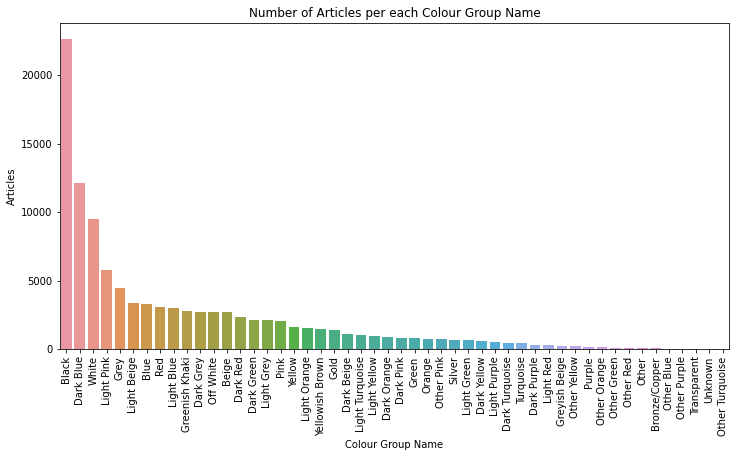

In [ ]:
temp = articles.groupby(["colour_group_name"])["article_id"].nunique()
df = pd.DataFrame({'Colour Group Name': temp.index,
                   'Articles': temp.values
                  })
df = df.sort_values(['Articles'], ascending=False)
plt.figure(figsize = (12,6))
plt.title(f'Number of Articles per each Colour Group Name')
sns.set_color_codes("pastel")
s = sns.barplot(x = 'Colour Group Name', y="Articles", data=df)
s.set_xticklabels(s.get_xticklabels(),rotation=90)
locs, labels = plt.xticks()
plt.show()

# [End First Look at Data]

#Implicit ALS Base Model

In [ ]:
pip install implicit

     |████████████████████████████████| 18.5 MB 1.3 MB/s 


In [ ]:
import os; os.environ['OPENBLAS_NUM_THREADS']='1'
import numpy as np
import pandas as pd
import implicit
from scipy.sparse import coo_matrix
from implicit.evaluation import mean_average_precision_at_k

/usr/local/lib/python3.7/dist-packages/implicit/gpu/__init__.py:14: UserWarning: CUDA extension is built, but disabling GPU support because of 'Cuda Error: no CUDA-capable device is detected (/project/./implicit/gpu/utils.h:71)'
  f"CUDA extension is built, but disabling GPU support because of '{e}'",


In [ ]:
# Trying with less data
train = train[train['t_dat'] > '2020-08-21']
train.shape

(1190911, 5)

In [ ]:
# For validation this means 3 weeks of training and 1 week for validation
# For submission, it means 4 weeks of training
train['t_dat'].max()

'2020-09-22'

## Assign autoincrementing ids starting from 0 to both users and items

In [ ]:
ALL_USERS = customers['customer_id'].unique().tolist()
ALL_ITEMS = articles['article_id'].unique().tolist()

user_ids = dict(list(enumerate(ALL_USERS)))
item_ids = dict(list(enumerate(ALL_ITEMS)))

user_map = {u: uidx for uidx, u in user_ids.items()}
item_map = {i: iidx for iidx, i in item_ids.items()}

train['user_id'] = train['customer_id'].map(user_map)
train['item_id'] = train['article_id'].map(item_map)

del customers, articles

#Create coo_matrix (user x item) and csr matrix (user x item)


In [ ]:
row = train['user_id'].values
col = train['item_id'].values
data = np.ones(train.shape[0])
coo_train = coo_matrix((data, (row, col)), shape=(len(ALL_USERS), len(ALL_ITEMS)))
coo_train

<1371980x105542 sparse matrix of type '<class 'numpy.float64'>'
	with 1190911 stored elements in COOrdinate format>

In [ ]:
%%time
model = implicit.als.AlternatingLeastSquares(factors=10, iterations=2)
model.fit(coo_train)

  0%|          | 0/2 [00:00<?, ?it/s]

CPU times: user 8.78 s, sys: 18.1 s, total: 26.9 s
Wall time: 14 s


## Validation
Functions required for validation

In [ ]:
def to_user_item_coo(train):
    """ Turn a dataframe with transactions into a COO sparse items x users matrix"""
    row = train['user_id'].values
    col = train['item_id'].values
    data = np.ones(train.shape[0])
    coo = coo_matrix((data, (row, col)), shape=(len(ALL_USERS), len(ALL_ITEMS)))
    return coo

In [ ]:
def split_data(train, validation_days=7):
    """ Split a pandas dataframe into training and validation data, using <<validation_days>>
    """
    validation_cut = train['t_dat'].max() - pd.Timedelta(validation_days)

    df_train = train[train['t_dat'] < validation_cut]
    df_val = train[train['t_dat'] >= validation_cut]
    return df_train, df_val

In [ ]:
def get_val_matrices(train, validation_days=7):
    """ Split into training and validation and create various matrices
        
        Returns a dictionary with the following keys:
            coo_train: training data in COO sparse format and as (users x items)
            csr_train: training data in CSR sparse format and as (users x items)
            csr_val:  validation data in CSR sparse format and as (users x items)
    
    """
    df_train, df_val = split_data(train, validation_days=validation_days)
    coo_train = to_user_item_coo(df_train)
    coo_val = to_user_item_coo(df_val)

    csr_train = coo_train.tocsr()
    csr_val = coo_val.tocsr()
    
    return {'coo_train': coo_train,
            'csr_train': csr_train,
            'csr_val': csr_val
          }

In [ ]:
def validate(matrices, factors=200, iterations=20, regularization=0.01, show_progress=True):
    """ Train an ALS model with <<factors>> (embeddings dimension) 
    for <<iterations>> over matrices and validate with MAP@12
    """
    coo_train, csr_train, csr_val = matrices['coo_train'], matrices['csr_train'], matrices['csr_val']
    
    model = implicit.als.AlternatingLeastSquares(factors=factors, 
                                                 iterations=iterations, 
                                                 regularization=regularization, 
                                                 random_state=42)
    model.fit(coo_train, show_progress=show_progress)
    
    # The MAPK by implicit doesn't allow to calculate allowing repeated items, which is the case.
    # TODO: change MAP@12 to a library that allows repeated items in prediction
    map12 = mean_average_precision_at_k(model, csr_train, csr_val, K=12, show_progress=show_progress, num_threads=4)
    print(f"Factors: {factors:>3} - Iterations: {iterations:>2} - Regularization: {regularization:4.3f} ==> MAP@12: {map12:6.5f}")
    return map12

In [ ]:
matrices = get_val_matrices(train)

TypeError: ignored

In [ ]:
%%time
best_map12 = 0
for factors in [40, 50, 60, 100, 200, 500, 1000]:
    for iterations in [3, 12, 14, 15, 20]:
        for regularization in [0.01]:
            map12 = validate(matrices, factors, iterations, regularization, show_progress=False)
            if map12 > best_map12:
                best_map12 = map12
                best_params = {'factors': factors, 'iterations': iterations, 'regularization': regularization}
                print(f"Best MAP@12 found. Updating: {best_params}")

NameError: ignored

In [ ]:
coo_train = to_user_item_coo(train)
csr_train = coo_train.tocsr()

In [ ]:
def training(coo_train, factors=200, iterations=15, regularization=0.01, show_progress=True):
    model = implicit.als.AlternatingLeastSquares(factors=factors, 
                                                 iterations=iterations, 
                                                 regularization=regularization, 
                                                 random_state=42)
    model.fit(coo_train, show_progress=show_progress)
    return model

In [ ]:
best_params

NameError: ignored

#[End Implicit ALS Base Model]

#Computer Vision

# [End Computer Vision]

## Basic Exploration of Each Dataset

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

In [ ]:
print(articles.shape)
print(train.shape)
print(customers.shape)

NameError: ignored

In [ ]:
sns.distplot(customers['age'])

NameError: ignored

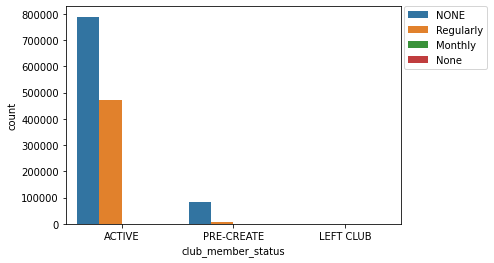

In [ ]:
sns.countplot(x='club_member_status',data=customers,hue='fashion_news_frequency')
plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0)
plt.show()

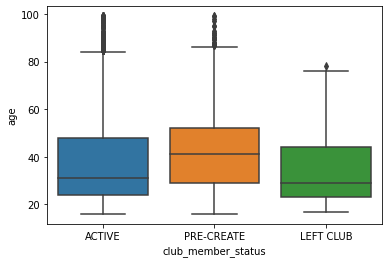

In [ ]:
sns.boxplot(x='club_member_status',y='age',data=customers)

Purchse counts by customer

In [ ]:
purchases_counts = train['article_id'].value_counts().reset_index()
purchases_counts.columns = ['article_id', 'qty']

Highly purchased articles

In [ ]:
purchases_counts.head(10)

,article_id,qty
0,706016001,50287
1,706016002,35043
2,372860001,31718
3,610776002,30199
4,759871002,26329
5,464297007,25025
6,372860002,24458
7,610776001,22451
8,399223001,22236
9,706016003,21241


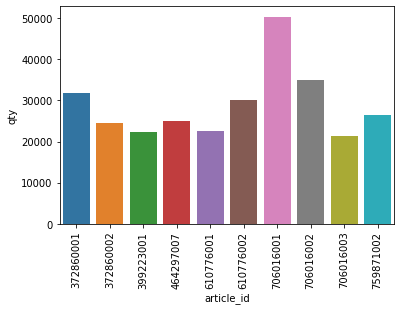

In [ ]:
sns.barplot(x = 'article_id',
            y = 'qty',
            data = purchases_counts.head(10))
plt.xticks(rotation=90)
plt.show()

Top Customers Based on Items Purchased

In [ ]:
customer_purchase_count = train['customer_id'].value_counts().reset_index()
customer_purchase_count.columns  = ['customer_id', 'items_purchased']

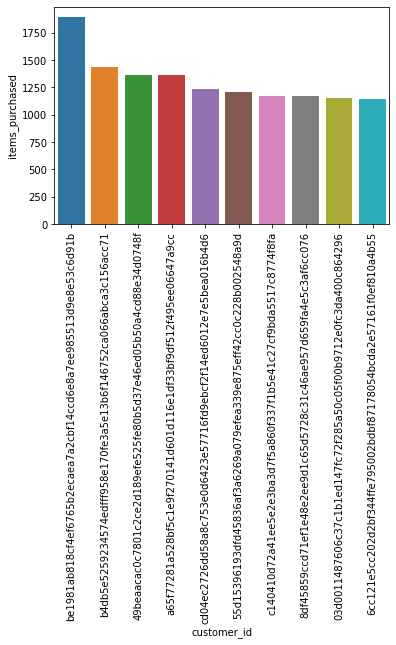

In [ ]:
sns.barplot(x = 'customer_id',
            y = 'items_purchased',
            data = customer_purchase_count.head(10))
plt.xticks(rotation=90)
plt.show()

Top 10 Customers based on Sales Amount

In [ ]:
sales = train.groupby(['customer_id'])['price'].sum().reset_index()

In [ ]:
sales.sort_values(by = 'price', ascending = False, inplace = True)
sales.reset_index(drop=True)

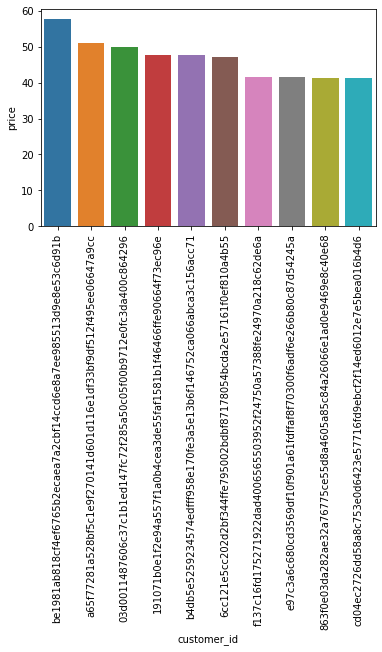

In [ ]:
sns.barplot(x = 'customer_id',
            y = 'price',
            data = sales.head(10))
plt.xticks(rotation=90)
plt.show()

In [ ]:
sales_articles = train.groupby(['article_id'])['price'].sum().reset_index()
sales_articles.sort_values(by = 'price', ascending = False, inplace = True)
sales_articles.reset_index(drop=True)

,article_id,price
0,706016001,1631.732102
1,706016002,1136.321085
2,568601006,939.268593
3,448509014,781.478390
4,706016003,692.195915
5,399223001,686.484780
6,720125001,683.606542
7,562245046,656.213763
8,751471001,590.639949
9,562245001,535.719898


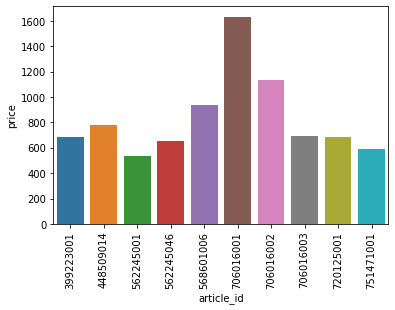

In [ ]:
sns.barplot(x = 'article_id',
            y = 'price',
            data = sales_articles.head(10))
plt.xticks(rotation=90)
plt.show()

In [ ]:
yearly_sales = train.groupby(['t_dat'])['price'].sum().reset_index()

In [ ]:
fig = px.line(yearly_sales, x='t_dat', y='price', title='Time Series with Yearly Sales')

fig.show()

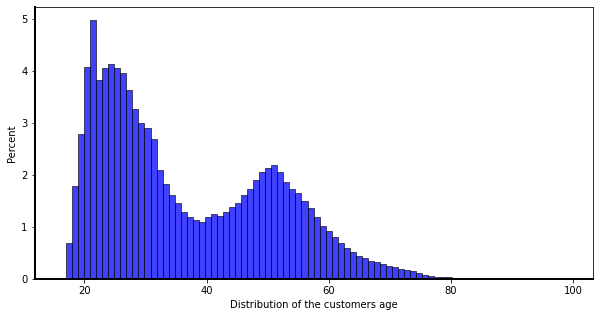

In [ ]:
fig, ax = plt.subplots(figsize=(10,5))
ax = sns.histplot(data=customers, x='age', bins=customers['age'].nunique(), color='blue', stat="percent")
ax.set_xlabel('Distribution of the customers age')
for loc in ['bottom', 'left']:
    ax.spines[loc].set_visible(True)
    ax.spines[loc].set_linewidth(2)
    ax.spines[loc].set_color('black')
plt.show()

# Code to get unique items


In [ ]:
# print(df.nunique(axis=1))

Writing Intermediate Predictions